In [95]:
include("../pic3d.jl")
using .PIC3D
using PyPlot
using LinearAlgebra
using PyCall
anim =  pyimport("matplotlib.animation");
using BenchmarkTools
using Profile
using PProf

In [96]:
function generate_particles!(NP, d)
    num = d / (2*NP / (PIC3D.XL*PIC3D.YL*PIC3D.ZL))
    println(num)
    electrons = PIC3D.Species(q=PIC3D.q_e*num, m=PIC3D.m_e*num)
    ions = PIC3D.Species(q=-PIC3D.q_e*num, m=PIC3D.m_e*num*2000)
    @inbounds for i = 1:NP
        x = [rand()*PIC3D.XL, rand()*PIC3D.YL, rand()*PIC3D.ZL]
        v = [5e5, 0, 0]
        push!(electrons.x, [x...])
        push!(electrons.v, [v...])
        push!(ions.x, [x...])
        push!(ions.v, [0.0, 0.0, 0.0])
        
        x = [rand()*PIC3D.XL, rand()*PIC3D.YL, rand()*PIC3D.ZL] #[rand()*PIC3D.XL, rand()*PIC3D.YL, rand()*PIC3D.ZL]
        v = [-5e5, 0, 0]
        push!(electrons.x, [x...])
        push!(electrons.v, [v...])
        push!(ions.x, [x...])
        push!(ions.v, [0.0, 0.0, 0.0])
    end

    return electrons, ions
end

generate_particles! (generic function with 1 method)

In [97]:
function compute_EK_particles(electrons, ions)
    ek = 0
    @inbounds for i in eachindex(electrons.v)
        ek += electrons.m*dot(electrons.v[i], electrons.v[i])
    end
    @inbounds for i in eachindex(ions.v)
        ek += ions.m*dot(ions.v[i], ions.v[i])
    end
    ek = 0.5*ek
    return ek
end

function compute_EK_particles2(electrons, ions, NP, d)
    ek = 0
    @inbounds for i in eachindex(electrons.v)
        ek += electrons.m*dot(electrons.v[i], electrons.v[i])
    end
    @inbounds for i in eachindex(ions.v)
        ek += electrons.m*dot(ions.v[i], ions.v[i])
    end
    ek = 0.5*ek*(d / (2*NP / (PIC3D.Δx*PIC3D.Δy*PIC3D.Δz)))
    return ek
end

function compute_EP_field()
    ep = 0
    @inbounds for k = 1:(PIC3D.NZ-1), j = 1:(PIC3D.NY-1), i = 1:(PIC3D.NX-1)
        ep += PIC3D.Ex[i,j,k]^2 + PIC3D.Ey[i,j,k]^2 + PIC3D.Ez[i,j,k]^2
    end
    ep = 0.5 * PIC3D.ε_0 * ep * PIC3D.Δx*PIC3D.Δy*PIC3D.Δz
    return ep
end


function compute_EP_potential()
    ep = 0
    @inbounds for k = 1:(PIC3D.NZ-1), j = 1:(PIC3D.NY-1), i = 1:(PIC3D.NX-1)
        ep += PIC3D.ρ[i,j,k] * PIC3D.ϕ[i,j,k]
    end
    ep = 0.5* PIC3D.ε_0 *ep
    return ep
end

compute_EP_potential (generic function with 1 method)

In [75]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 3000

@btime PIC3D.timestep_FFT!(electrons, ions, 1)

4.500000000000001e6
  7.528 ms (154 allocations: 3.27 MiB)


In [89]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 3000

@btime PIC3D.timestep_FFT!(electrons, ions, 1)

562500.0000000001
  1.719 ms (2 allocations: 32.06 KiB)


In [84]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 3000

@btime PIC3D.timestep_FFT!(electrons, ions, 1)

562500.0000000001
  1.542 ms (2 allocations: 32.06 KiB)


In [29]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 3000

@btime PIC3D.charge_deposition2!(electrons)

562500.0000000001
  199.200 μs (0 allocations: 0 bytes)


In [70]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 3000

Profile.Allocs.clear()
Profile.Allocs.@profile sample_rate=1 PIC3D.compute_potential_FFT!()
PProf.Allocs.pprof(from_c = false)

4.500000000000001e6

Analyzing 152 allocation samples...   1%|█               |  ETA: 0:00:15

Analyzing 152 allocation samples... 100%|████████████████| Time: 0:00:00


"alloc-profile.pb.gz"

Main binary filename not available.
Serving web UI on http://localhost:62261


In [117]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)
@btime PIC3D.boris_pusher!(electrons, 1)

4.500000000000001e6
  518.500 μs (0 allocations: 0 bytes)


In [118]:
@btime PIC3D.compute_potential_FFT!();

  5.388 ms (152 allocations: 3.02 MiB)


In [119]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)
@btime PIC3D.charge_deposition!(electrons)

4.500000000000001e6
  143.400 μs (0 allocations: 0 bytes)


In [32]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 3000

@btime PIC3D.timestep_FFT!(electrons, ions, 1)

562500.0000000001


LoadError: InexactError: Float64(-135.3046564808639 + 11.809707798961092im)

562500.0000000001
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
27

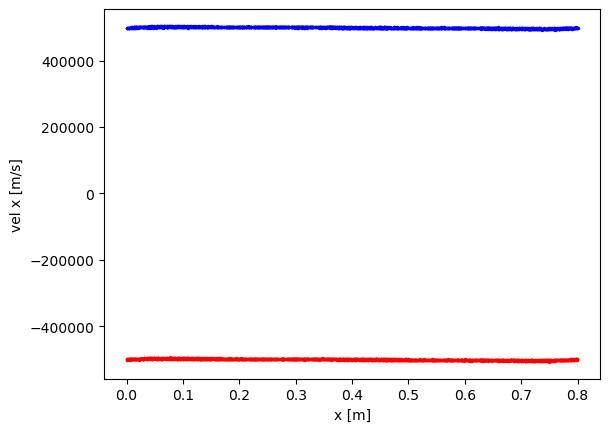

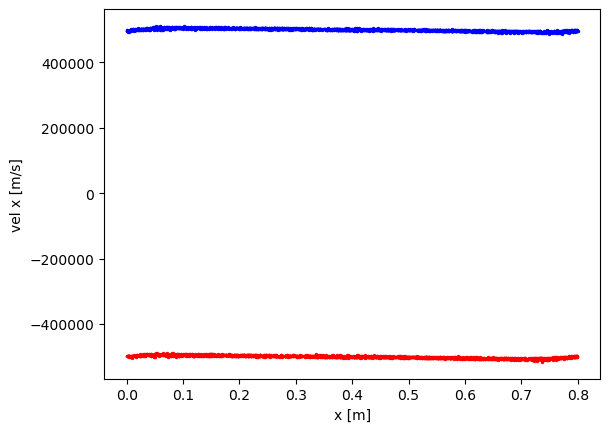

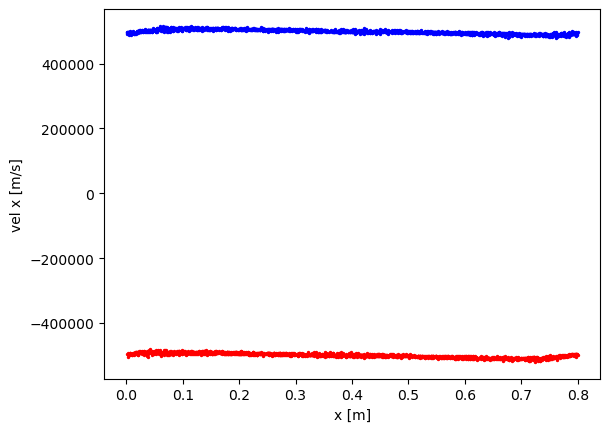

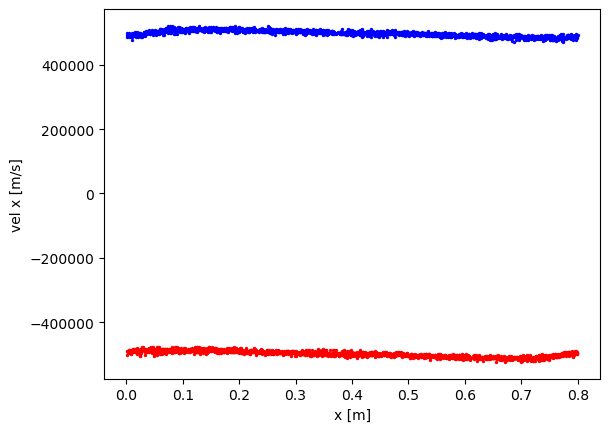

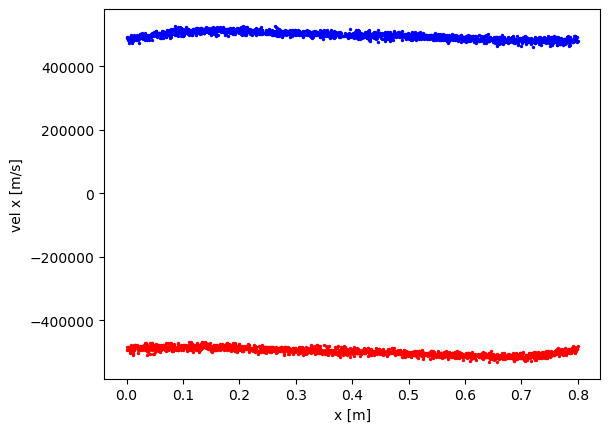

...

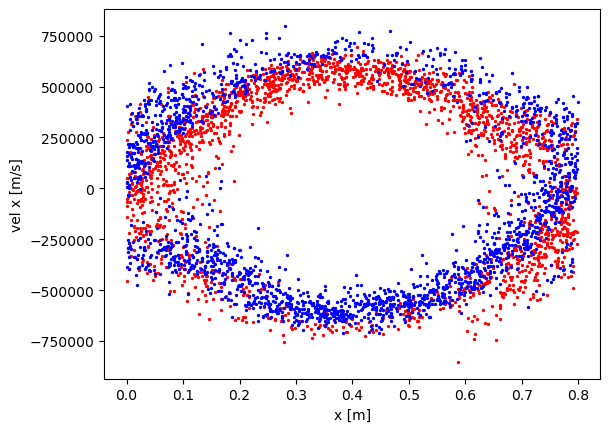

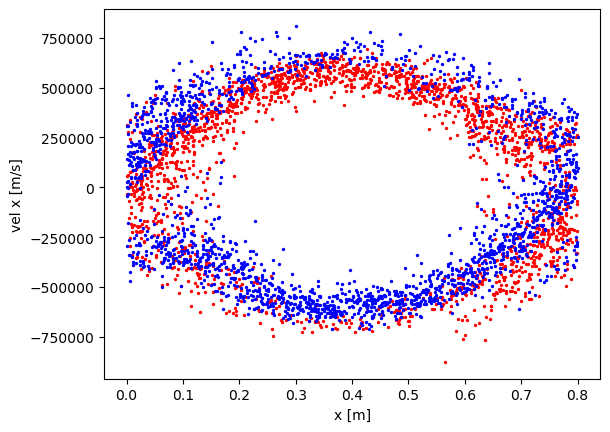

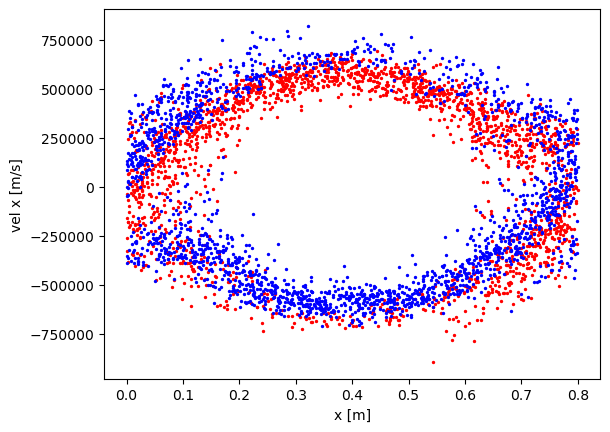

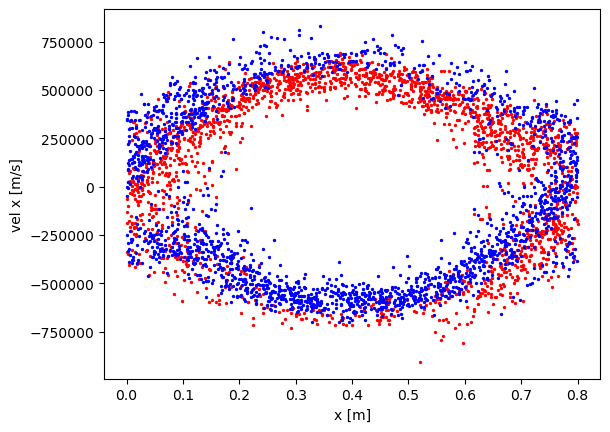

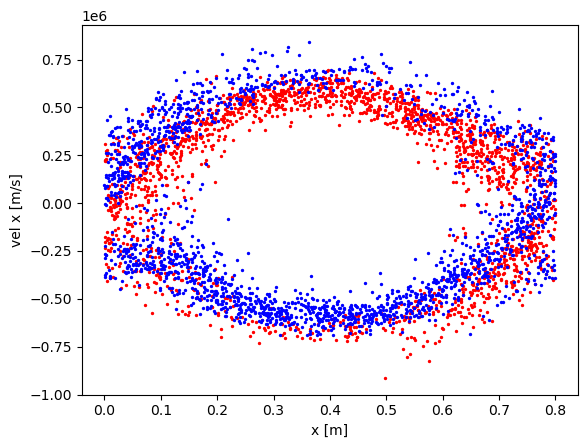

In [94]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 3000

historyxx = []
historyvel = []
EK = []
EK2 = []
EE = []
EP = []

for i = 1:timesteps
    println(i)
    PIC3D.timestep_FFT!(electrons, ions, 1)
    if i % 25 == 0
        plt.figure()
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 0],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 0], color="red", label="c = 1", s=2)
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 1],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 1], color="blue", label="c = 1", s=2)
        plt.xlabel("x [m]")
        plt.ylabel("vel x [m/s]")
        plt.show()
        push!(historyxx, [[ex...] for ex in electrons.x])
        push!(historyvel, [[ev...] for ev in electrons.v])
    end
    push!(EK, compute_EK_particles(electrons, ions))
    push!(EK2, compute_EK_particles2(electrons, ions, NP, d))
    push!(EE, compute_EP_field())
    push!(EP, compute_EP_potential())
end

In [25]:
PIC3D.ρ̂

32×16×16 Array{Float64, 3}:
[:, :, 1] =
     4.54747e-12  -10607.1      -10707.9    …  -10707.9    -10607.1
     0.0            -777.761     -2127.6         2127.6       777.761
 -8239.56            264.626       178.914        468.07      593.484
   719.168          1862.04       -177.307        856.227     322.677
 -9141.7            -229.229      -293.45        -180.802     738.227
  -108.263          -293.209      -615.774  …     379.094    -101.332
 -8313.06           1535.81       1289.35         599.184     946.239
  -702.08           -389.84       -714.046        583.854     272.133
 -9073.6              -5.68505    -643.783       -216.07     -682.896
  -936.306            80.1785    -1596.77         504.728     163.015
 -8848.92            286.831       802.104  …     306.63      662.896
    11.2565         -529.936      -734.708        921.485     313.367
 -9174.42             17.856       472.457        510.388     836.558
     ⋮                                      ⋱       

In [26]:
PIC3D.ρfft

16×16×16 Array{ComplexF64, 3}:
[:, :, 1] =
 4.54747e-12+0.0im      -10607.1-777.761im  …  -10607.1+777.761im
    -8239.56+719.168im   264.626+1862.04im      593.484+322.677im
     -9141.7-108.263im  -229.229-293.209im      738.227-101.332im
    -8313.06-702.08im    1535.81-389.84im       946.239+272.133im
     -9073.6-936.306im  -5.68505+80.1785im     -682.896+163.015im
    -8848.92+11.2565im   286.831-529.936im  …   662.896+313.367im
    -9174.42-79.1478im    17.856+92.1282im      836.558+230.049im
    -8269.77+44.6909im   1007.81-124.69im       1154.56+314.445im
    -7455.42+0.0im       543.574-401.16im       543.574+401.16im
    -8269.77-44.6909im   1154.56-314.445im      1007.81+124.69im
    -9174.42+79.1478im   836.558-230.049im  …    17.856-92.1282im
    -8848.92-11.2565im   662.896-313.367im      286.831+529.936im
     -9073.6+936.306im  -682.896-163.015im     -5.68505-80.1785im
    -8313.06+702.08im    946.239-272.133im      1535.81+389.84im
     -9141.7+108.263im   738.227+101

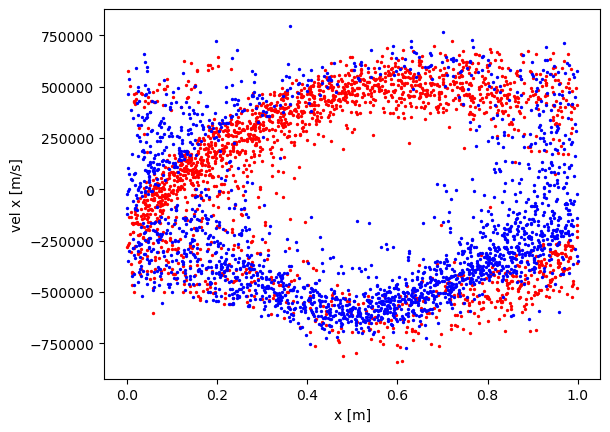

In [63]:
plt.figure()
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 0],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 0], color="red", label="c = 1", s=2)
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 1],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 1], color="blue", label="c = 1", s=2)
        plt.xlabel("x [m]")
        plt.ylabel("vel x [m/s]")
        plt.show()

In [24]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 3000

historyxx = []
historyvel = []
EK = []
EK2 = []
EE = []
EP = []

for i = 1:timesteps
    println(i)
    PIC3D.timestep_FFT!(electrons, ions, 1)
    if i % 25 == 0
        plt.figure()
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 0],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 0], color="red", label="c = 1", s=2)
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 1],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 1], color="blue", label="c = 1", s=2)
        plt.xlabel("x [m]")
        plt.ylabel("vel x [m/s]")
        plt.show()
        push!(historyxx, [[ex...] for ex in electrons.x])
        push!(historyvel, [[ev...] for ev in electrons.v])
    end
    push!(EK, compute_EK_particles(electrons, ions))
    push!(EK2, compute_EK_particles2(electrons, ions, NP, d))
    push!(EE, compute_EP_field())
    push!(EP, compute_EP_potential())
end

1.0986328125e6
1
2


LoadError: InexactError: trunc(Int64, NaN)

MovieWriter ffmpeg unavailable; using Pillow instead.


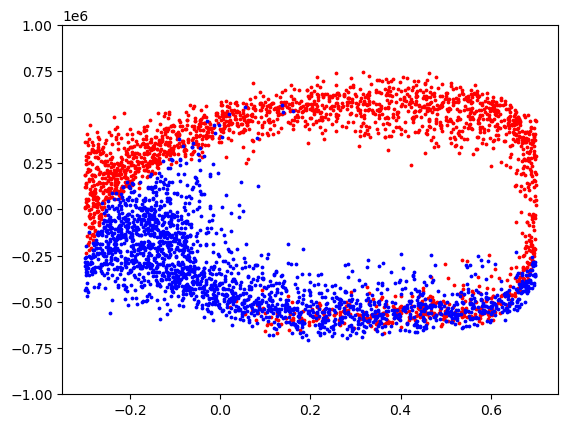

In [34]:
fig = plt.figure()
ax = plt.gca()
ax.set_ylim([-1e6,1e6])
function make_frame(i)
    plt.cla()
 ax.set_ylim([-1e6,1e6])
    firstx = historyxx[i+1][1:2:(size(historyxx[1])[1])]
    firstv = historyvel[i+1][1:2:(size(historyxx[1])[1])]
    plt.scatter([p[1]-0.3 for p in firstx], [p[1] for p in firstv], s =3, color="red")
    secondx = historyxx[i+1][2:2:(size(historyxx[1])[1] )]
    secondv = historyvel[i+1][2:2:(size(historyxx[1])[1])]
    plt.scatter([p[1]-0.3 for p in secondx], [p[1] for p in secondv], s =3, color="blue")
end

myanim = anim.FuncAnimation(fig, make_frame, frames=size(historyxx, 1), interval=100, blit=false)
myanim[:save]("sym20FFT.gif", bitrate=-1)


In [38]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

@btime PIC3D.timestep!(electrons, ions, 1.0)

1.0986328125e6
GS failed to converge, L2 = 0.002645792414300206
GS failed to converge, L2 = 0.002645968977827824
GS failed to converge, L2 = 0.002673069495888779
GS failed to converge, L2 = 0.0026641239657480744
GS failed to converge, L2 = 0.002673194607289417
GS failed to converge, L2 = 0.0026731968220033517
GS failed to converge, L2 = 0.002664225905976906
GS failed to converge, L2 = 0.0026642753787388114
GS failed to converge, L2 = 0.002673192312714111
GS failed to converge, L2 = 0.002673108158050531
GS failed to converge, L2 = 0.0026820091522425575
GS failed to converge, L2 = 0.0026859379962831014
  1.472 s (41107 allocations: 3.14 MiB)


In [23]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

@btime PIC3D.timestep!(electrons, ions, 1.0)

1.0986328125e6
GS failed to converge, L2 = 0.0025255150859355207
GS failed to converge, L2 = 0.0025347248484086085
GS failed to converge, L2 = 0.0025440035994413455
GS failed to converge, L2 = 0.0025353496010877773
  7.598 s (41110 allocations: 3.14 MiB)


1
Converged after 200 iterations, L2 = 3.464582904464753e-9
2
Converged after 200 iterations, L2 = 3.4653242511936327e-9
3
Converged after 200 iterations, L2 = 3.464812424816726e-9
4
Converged after 200 iterations, L2 = 3.4702561602361272e-9
5
Converged after 200 iterations, L2 = 3.4673643509299057e-9
6
Converged after 200 iterations, L2 = 3.4589642735106786e-9
7
Converged after 200 iterations, L2 = 3.4476735770656402e-9
8
Converged after 200 iterations, L2 = 3.4594502196819414e-9
9
Converged after 200 iterations, L2 = 3.4554925742028026e-9
10
Converged after 200 iterations, L2 = 3.4457225195349955e-9
11
Converged after 200 iterations, L2 = 3.434616086714261e-9
12
Converged after 200 iterations, L2 = 3.430471989866255e-9
13
Converged after 200 iterations, L2 = 3.426376452862482e-9
14
Converged after 200 iterations, L2 = 3.4307951548316222e-9
15
Converged after 200 iterations, L2 = 3.4301983749641797e-9
16
Converged after 200 iterations, L2 = 3.4220580856002173e-9
17
Converged after 200

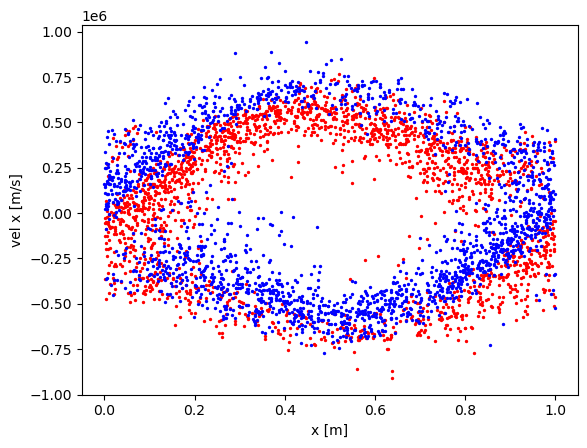

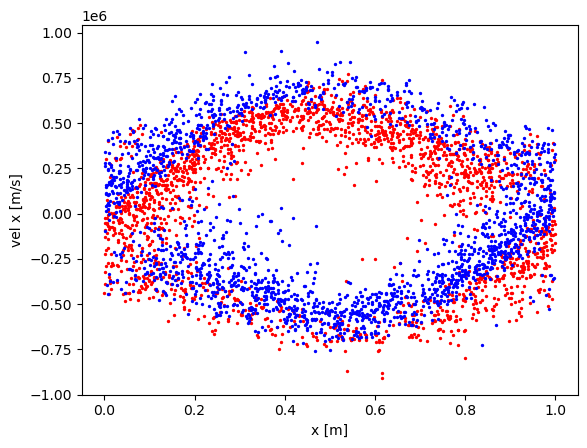

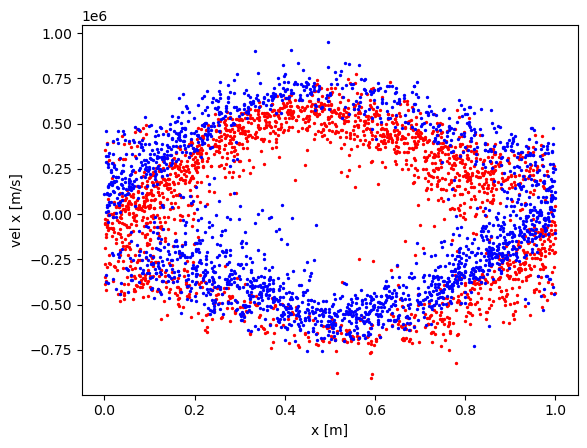

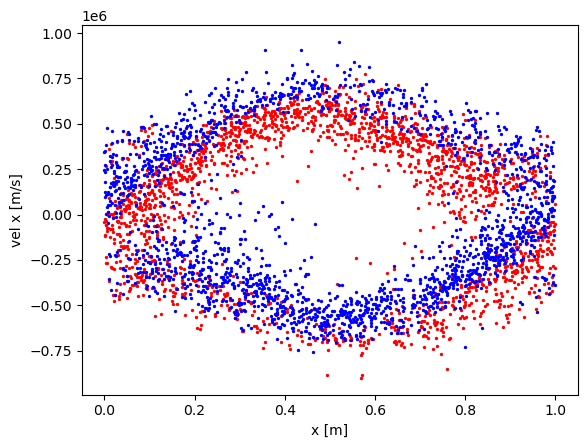

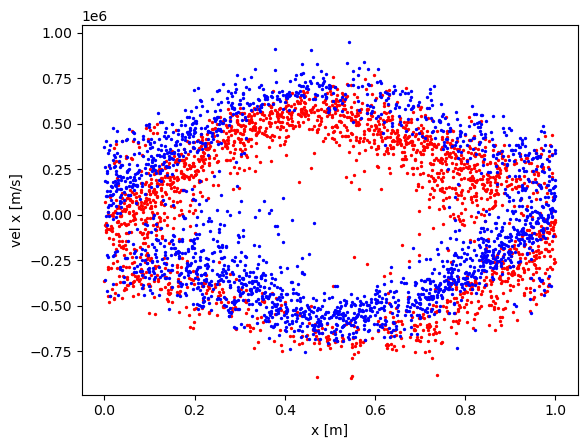

...

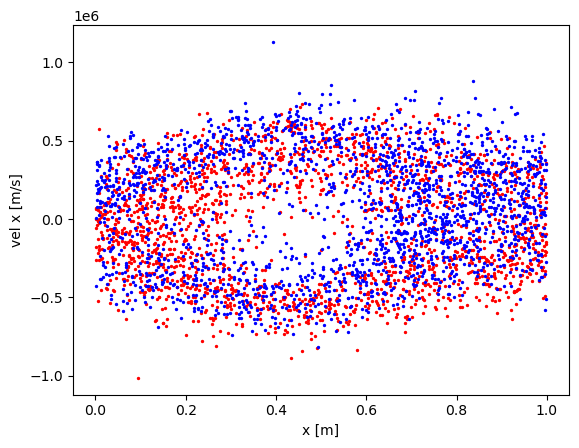

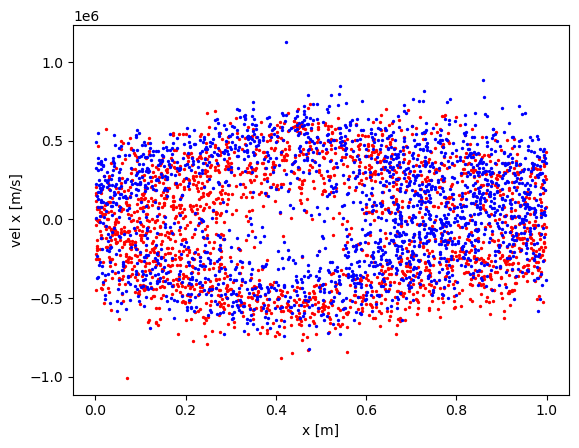

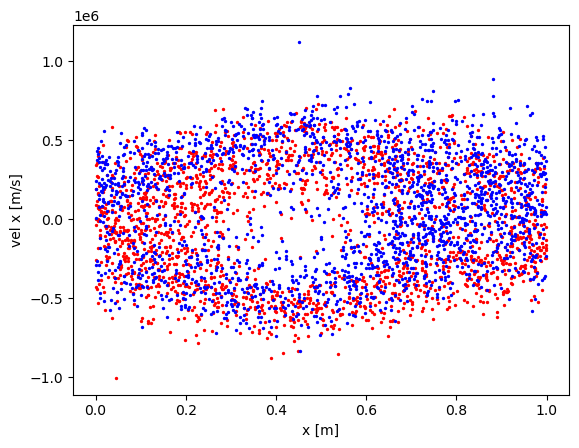

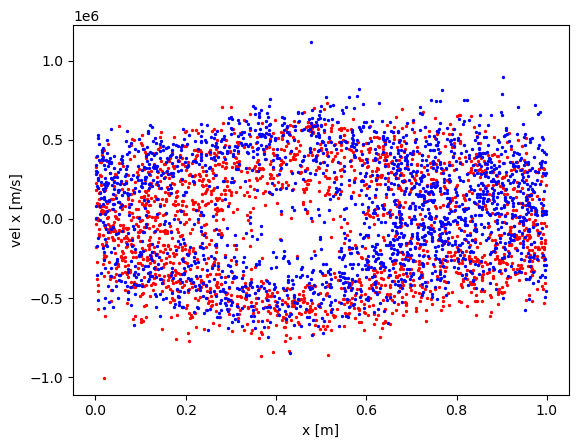

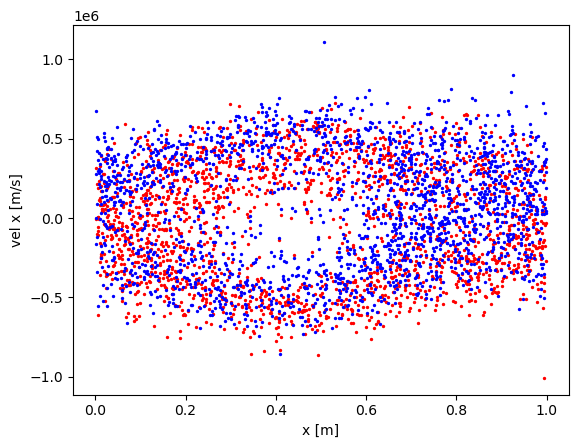

In [9]:
# NP = 2048 #2048
# d = 4.5e9
# electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 4000

# historyxx = []
# historyvel = []
# EK = []
# EK2 = []
# EE = []
# EP = []

for i = 1:timesteps
    println(i)
    PIC3D.timestep!(electrons, ions, 1)
    if i % 25 == 0
        plt.figure()
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 0],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 0], color="red", label="c = 1", s=2)
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 1],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 1], color="blue", label="c = 1", s=2)
        plt.xlabel("x [m]")
        plt.ylabel("vel x [m/s]")
        plt.show()
        push!(historyxx, [[ex...] for ex in electrons.x])
        push!(historyvel, [[ev...] for ev in electrons.v])
    end
    push!(EK, compute_EK_particles(electrons, ions))
    push!(EK2, compute_EK_particles2(electrons, ions, NP, d))
    push!(EE, compute_EP_field())
    push!(EP, compute_EP_potential())
end

1.0986328125e6
1
GS failed to converge, L2 = 0.002645792414299869
2
GS failed to converge, L2 = 0.0026459689778274846
3
GS failed to converge, L2 = 0.0026730694958885647
4
GS failed to converge, L2 = 0.0026641239657482366
5
GS failed to converge, L2 = 0.002673194607289381
6
GS failed to converge, L2 = 0.002673196822003501
7
GS failed to converge, L2 = 0.0026642259059771853
8
GS failed to converge, L2 = 0.0026642753787389666
9
GS failed to converge, L2 = 0.0026731923127142547
10
GS failed to converge, L2 = 0.00267310815805045
11
GS failed to converge, L2 = 0.002682009152242478
12
GS failed to converge, L2 = 0.002685937996283351
13
GS failed to converge, L2 = 0.0026751718125194537
14
GS failed to converge, L2 = 0.0026754219224229773
15
GS failed to converge, L2 = 0.0026667822104009926
16
GS failed to converge, L2 = 0.002667262549608136
17
GS failed to converge, L2 = 0.002676745157589588
18
GS failed to converge, L2 = 0.002704154560578515
19
GS failed to converge, L2 = 0.00270444339172896

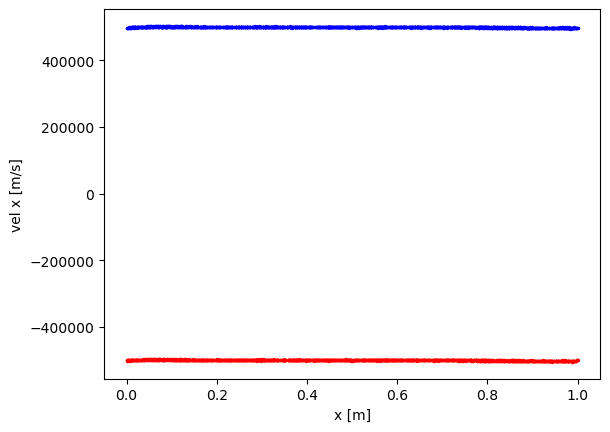

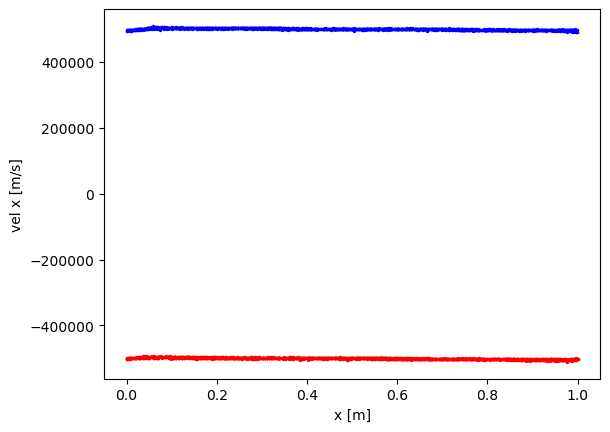

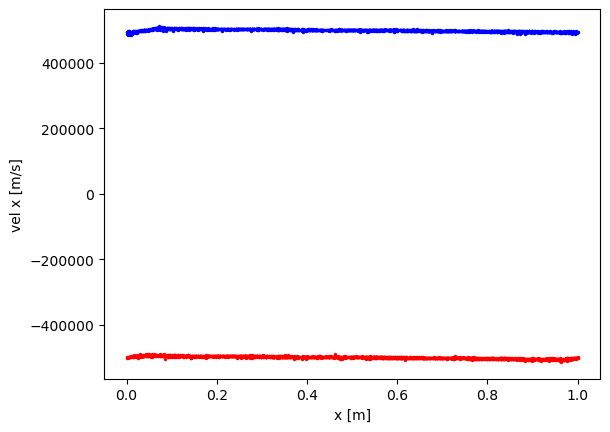

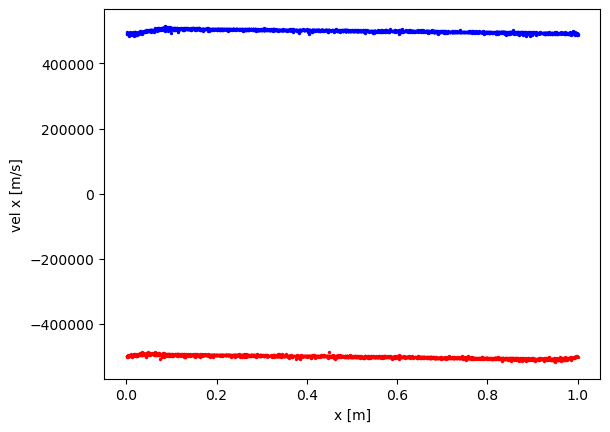

In [129]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 100

historyxx = []
historyvel = []
EK = []
EK2 = []
EE = []
EP = []

for i = 1:timesteps
    println(i)
    PIC3D.timestep!(electrons, ions, 1.0)
    if i % 25 == 0
        plt.figure()
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 0],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 0], color="red", label="c = 1", s=2)
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 1],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 1], color="blue", label="c = 1", s=2)
        plt.xlabel("x [m]")
        plt.ylabel("vel x [m/s]")
        plt.show()
        push!(historyxx, [[ex...] for ex in electrons.x])
        push!(historyvel, [[ev...] for ev in electrons.v])
    end
    push!(EK, compute_EK_particles(electrons, ions))
    push!(EK2, compute_EK_particles2(electrons, ions, NP, d))
    push!(EE, compute_EP_field())
    push!(EP, compute_EP_potential())
end

1.0986328125e6
1
GS failed to converge, L2 = 0.002645802733115265
2
GS failed to converge, L2 = 0.0026459796396390207
3
GS failed to converge, L2 = 0.0026730811030247223
4
GS failed to converge, L2 = 0.002664136634661723
5
GS failed to converge, L2 = 0.0026732091551245085
6
GS failed to converge, L2 = 0.0026732140776757132
7
GS failed to converge, L2 = 0.0026642450941170904
8
GS failed to converge, L2 = 0.00266429782556715
9
GS failed to converge, L2 = 0.002673219457276672
10
GS failed to converge, L2 = 0.002673139318515591
11
GS failed to converge, L2 = 0.002682045833831452
12
GS failed to converge, L2 = 0.002685979906695252
13
GS failed to converge, L2 = 0.0026752162307852483
14
GS failed to converge, L2 = 0.0026754687197348068
15
GS failed to converge, L2 = 0.0026668319154540474
16
GS failed to converge, L2 = 0.0026673170785962495
17
GS failed to converge, L2 = 0.0026768093228671306
18
GS failed to converge, L2 = 0.002704227497633813
19
GS failed to converge, L2 = 0.0027045242155373

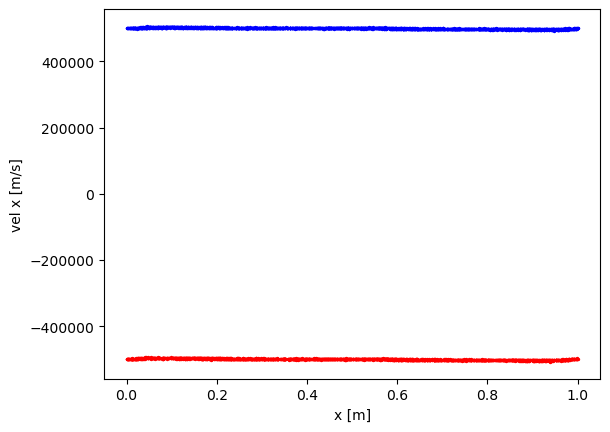

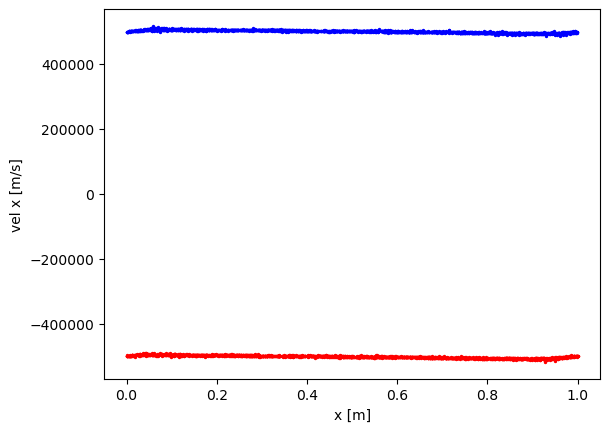

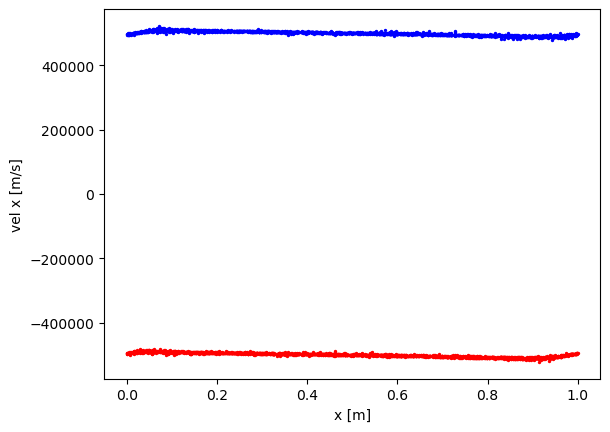

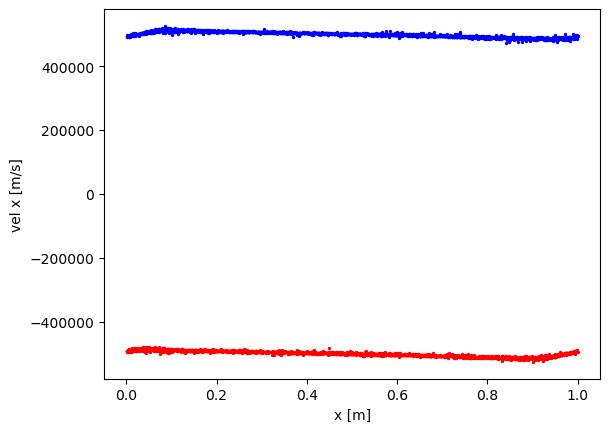

In [11]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 3000

historyxx = []
historyvel = []
EK = []
EK2 = []
EE = []
EP = []

for i = 1:timesteps
    println(i)
    PIC3D.timestep!(electrons, ions, 1.0)
    if i % 25 == 0
        plt.figure()
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 0],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 0], color="red", label="c = 1", s=2)
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 1],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 1], color="blue", label="c = 1", s=2)
        plt.xlabel("x [m]")
        plt.ylabel("vel x [m/s]")
        plt.show()
        push!(historyxx, [[ex...] for ex in electrons.x])
        push!(historyvel, [[ev...] for ev in electrons.v])
    end
    push!(EK, compute_EK_particles(electrons, ions))
    push!(EK2, compute_EK_particles2(electrons, ions, NP, d))
    push!(EE, compute_EP_field())
    push!(EP, compute_EP_potential())
end

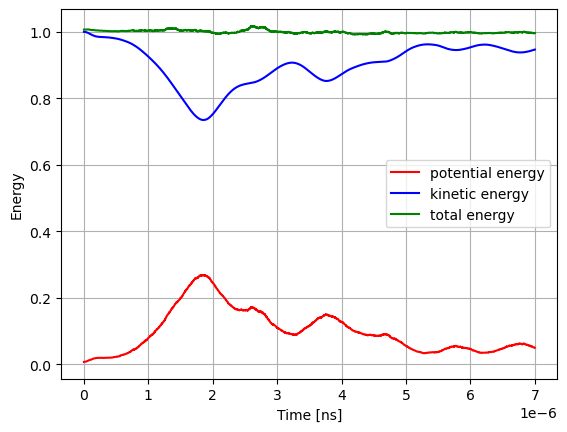

In [15]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
plt.plot(times, EE ./ EK[1], linestyle="solid", color="red", label="potential energy")
plt.plot(times, EK ./ EK[1], linestyle="solid", color="blue", label="kinetic energy")
plt.plot(times, EE ./ EK[1] + EK ./ EK[1], linestyle="solid", color="green", label="total energy")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.legend()
plt.xlabel("Time [ns]")
plt.ylabel("Energy")
plt.savefig("energy.png")

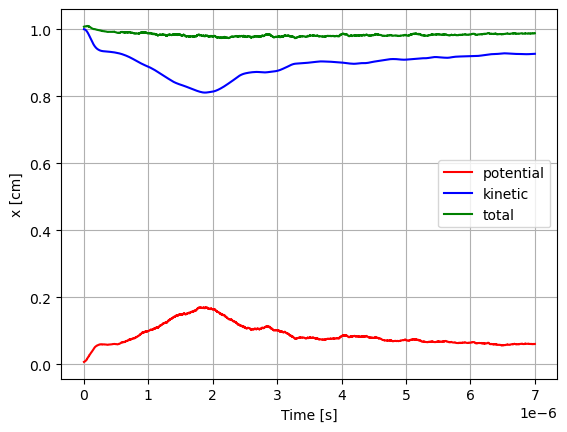

PyObject Text(24.000000000000007, 0.5, 'x [cm]')

In [18]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
plt.plot(times, EE ./ EK[1], linestyle="solid", color="red", label="potential")
plt.plot(times, EK ./ EK[1], linestyle="solid", color="blue", label="kinetic")
plt.plot(times, EE ./ EK[1] + EK ./ EK[1], linestyle="solid", color="green", label="total")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.legend()
plt.xlabel("Time [s]")
plt.ylabel("x [cm]")

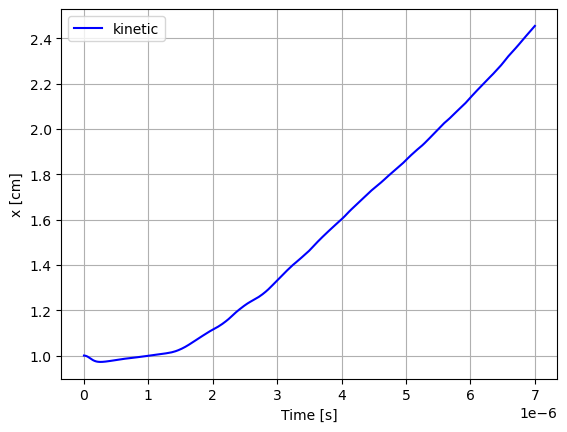

PyObject Text(24.000000000000007, 0.5, 'x [cm]')

In [13]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
#plt.plot(times, EE ./ EK[1], linestyle="solid", color="red", label="potential")
plt.plot(times, EK ./ EK[1], linestyle="solid", color="blue", label="kinetic")
#plt.plot(times, EE ./ EK[1] + EK ./ EK[1], linestyle="solid", color="green", label="total")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.legend()
plt.xlabel("Time [s]")
plt.ylabel("x [cm]")

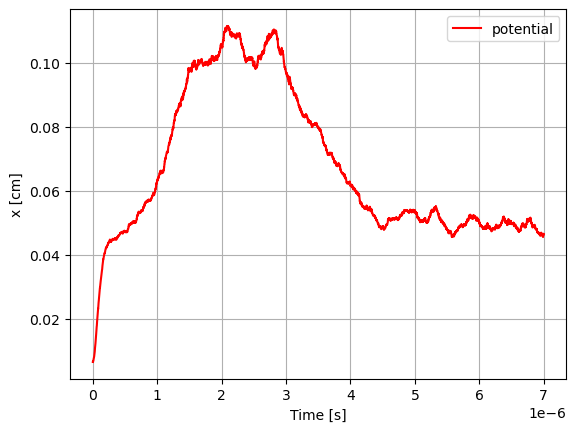

PyObject Text(24.000000000000007, 0.5, 'x [cm]')

In [12]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
plt.plot(times, EE ./ EK[1], linestyle="solid", color="red", label="potential")
#plt.plot(times, EK ./ EK[1], linestyle="solid", color="blue", label="kinetic")
#plt.plot(times, EE ./ EK[1] + EK ./ EK[1], linestyle="solid", color="green", label="total")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.legend()
plt.xlabel("Time [s]")
plt.ylabel("x [cm]")

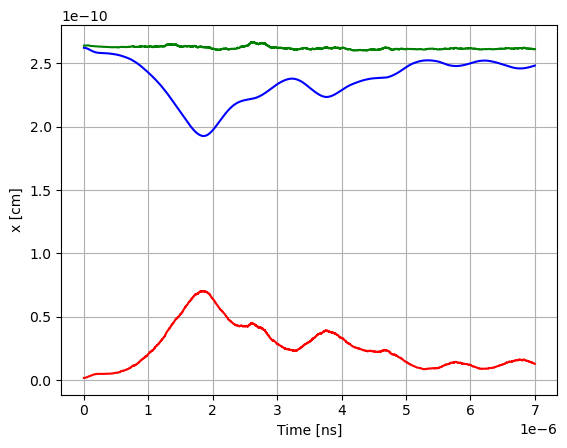

PyObject Text(24.000000000000007, 0.5, 'x [cm]')

In [12]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
plt.plot(times, EE , linestyle="solid", color="red")
plt.plot(times, EK , linestyle="solid", color="blue")
plt.plot(times, EE + EK , linestyle="solid", color="green")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.xlabel("Time [ns]")
plt.ylabel("x [cm]")

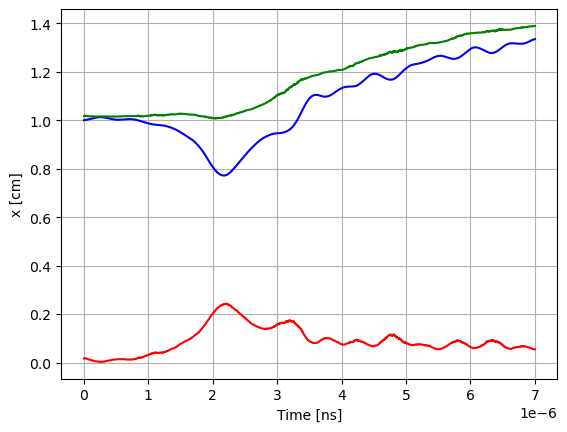

PyObject Text(24.000000000000007, 0.5, 'x [cm]')

In [29]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
plt.plot(times, EE ./ EK[1], linestyle="solid", color="red")
plt.plot(times, EK ./ EK[1], linestyle="solid", color="blue")
plt.plot(times, EE ./ EK[1] + EK ./ EK[1], linestyle="solid", color="green")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.xlabel("Time [s]")
plt.ylabel("x [cm]")

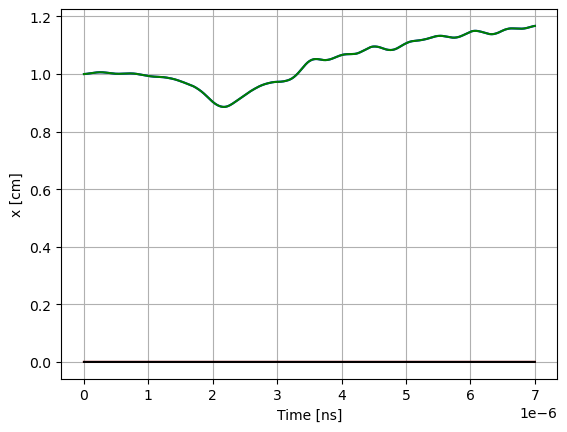

PyObject Text(24.000000000000007, 0.5, 'x [cm]')

In [22]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
plt.plot(times, EE ./ EK2[1], linestyle="solid", color="red")
plt.plot(times, EK2 ./ EK2[1], linestyle="solid", color="blue")
plt.plot(times, EE ./ EK2[1] + EK2 ./ EK2[1], linestyle="solid", color="green")
plt.plot(times, EP ./ EK2[1], linestyle="solid", color="black")
plt.grid()
plt.xlabel("Time [ns]")
plt.ylabel("x [cm]")

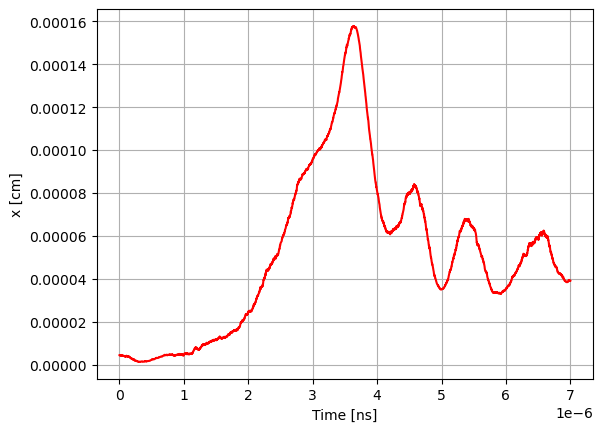

PyObject Text(24.0, 0.5, 'x [cm]')

In [66]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
plt.plot(times, EE ./ EK[1], linestyle="solid", color="red")
#plt.plot(times, EK ./ EK[1], linestyle="solid", color="blue")
#plt.plot(times, EE ./ EK[1] + EK ./ EK[1], linestyle="solid", color="green")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.xlabel("Time [ns]")
plt.ylabel("x [cm]")

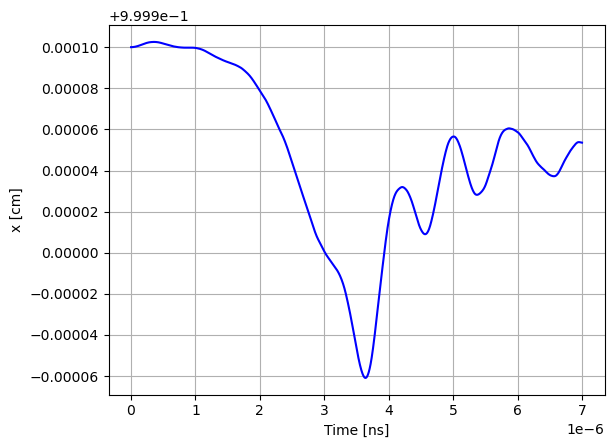

PyObject Text(24.0, 0.5, 'x [cm]')

In [67]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
#plt.plot(times, EE ./ EK[1], linestyle="solid", color="red")
plt.plot(times, EK ./ EK[1], linestyle="solid", color="blue")
#plt.plot(times, EE ./ EK[1] + EK ./ EK[1], linestyle="solid", color="green")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.xlabel("Time [ns]")
plt.ylabel("x [cm]")